## Assignment 2: Time Series Forecasting

### \Alex Nguyen \a1848722

#### Follow detail instructions in the assignment specification and use these heading for implementation and discussion

### 1. Read the dataset

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import statsmodels.api as sm

from datetime import datetime
from pmdarima import preprocessing as AutoARIMA
from pmdarima.preprocessing import FourierFeaturizer
from sklearn.metrics import mean_absolute_error, root_mean_squared_error
from sklearn.model_selection import train_test_split
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from statsmodels.tsa.stattools import adfuller
from pmdarima import pipeline

In [2]:
data = pd.read_csv('energydata_complete.csv')
data

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.890000,47.596667,19.200000,44.790000,19.790000,44.730000,19.000000,...,17.033333,45.5300,6.600000,733.5,92.000000,7.000000,63.000000,5.300000,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.890000,46.693333,19.200000,44.722500,19.790000,44.790000,19.000000,...,17.066667,45.5600,6.483333,733.6,92.000000,6.666667,59.166667,5.200000,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.890000,46.300000,19.200000,44.626667,19.790000,44.933333,18.926667,...,17.000000,45.5000,6.366667,733.7,92.000000,6.333333,55.333333,5.100000,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.890000,46.066667,19.200000,44.590000,19.790000,45.000000,18.890000,...,17.000000,45.4000,6.250000,733.8,92.000000,6.000000,51.500000,5.000000,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.890000,46.333333,19.200000,44.530000,19.790000,45.000000,18.890000,...,17.000000,45.4000,6.133333,733.9,92.000000,5.666667,47.666667,4.900000,10.084097,10.084097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19730,2016-05-27 17:20:00,100,0,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.700000,...,23.200000,46.7900,22.733333,755.2,55.666667,3.333333,23.666667,13.333333,43.096812,43.096812
19731,2016-05-27 17:30:00,90,0,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.700000,...,23.200000,46.7900,22.600000,755.2,56.000000,3.500000,24.500000,13.300000,49.282940,49.282940
19732,2016-05-27 17:40:00,270,10,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.700000,...,23.200000,46.7900,22.466667,755.2,56.333333,3.666667,25.333333,13.266667,29.199117,29.199117
19733,2016-05-27 17:50:00,420,10,25.500000,46.990000,25.414000,43.036000,26.890000,41.290000,24.700000,...,23.200000,46.8175,22.333333,755.2,56.666667,3.833333,26.166667,13.233333,6.322784,6.322784


### 2. Analyse and visualise the data

#### 2.1 Skimming data

In [3]:
# check data type and NA
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   lights       19735 non-null  int64  
 3   T1           19735 non-null  float64
 4   RH_1         19735 non-null  float64
 5   T2           19735 non-null  float64
 6   RH_2         19735 non-null  float64
 7   T3           19735 non-null  float64
 8   RH_3         19735 non-null  float64
 9   T4           19735 non-null  float64
 10  RH_4         19735 non-null  float64
 11  T5           19735 non-null  float64
 12  RH_5         19735 non-null  float64
 13  T6           19735 non-null  float64
 14  RH_6         19735 non-null  float64
 15  T7           19735 non-null  float64
 16  RH_7         19735 non-null  float64
 17  T8           19735 non-null  float64
 18  RH_8         19735 non-null  float64
 19  T9  

In [4]:
data.columns

Index(['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')

In [5]:
# Rv1 and rv2 are introduced to dataset to reduce features from initial dataset to test Boruta algorithm [1]. We don't need them anymore, so drop.
data = data.drop(['rv1', 'rv2'], axis = 1)
data.columns

Index(['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint'],
      dtype='object')

In [6]:
# rename variables
rename_dict = {
   'Appliances': 'appliance',
   'lights': 'light',
   'T1': 'temp_kitchen',
   'RH_1': 'humid_kitchen',
   'T2': 'temp_living',
   'RH_2': 'humid_living',
   'T3': 'temp_laundry',
   'RH_3': 'humid_laundry',
   'T4': 'temp_office',
   'RH_4': 'humid_office',
   'T5': 'temp_bath',
   'RH_5': 'humid_bath',
   'T6': 'temp_outbuilding',
   'RH_6': 'humid_outbuilding',
   'T7': 'temp_iron',
   'RH_7': 'humid_iron',
   'T8': 'temp_kid',
   'RH_8': 'humid_kid',
   'T9': 'temp_parent',
   'RH_9': 'humid_parent',
   'T_out': 'tempt_weather',
   'Press_mm_hg': 'pressure_weather',
   'RH_out': 'humid_weather',
   'Windspeed': 'wind_weather',
   'Visibility': 'vis_weather',
   'Tdewpoint': 'tdew_weather',
   'rv1': 'random_1',
   'rv2': 'random_2'
}

data.rename(columns=rename_dict, inplace=True)
data.columns

Index(['date', 'appliance', 'light', 'temp_kitchen', 'humid_kitchen',
       'temp_living', 'humid_living', 'temp_laundry', 'humid_laundry',
       'temp_office', 'humid_office', 'temp_bath', 'humid_bath',
       'temp_outbuilding', 'humid_outbuilding', 'temp_iron', 'humid_iron',
       'temp_kid', 'humid_kid', 'temp_parent', 'humid_parent', 'tempt_weather',
       'pressure_weather', 'humid_weather', 'wind_weather', 'vis_weather',
       'tdew_weather'],
      dtype='object')

In [7]:
# as [1, p. 93], time information is the most important feature to appliance's energy consumption, we create this variable as well
data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S', utc=True)

def convert_to_seconds(x):
    return x.hour * 3600 + x.minute * 60 + x.second

data['sec_midnight'] = data['date'].apply(convert_to_seconds)
data['sec_midnight'].describe()

count    19735.000000
mean     42907.129465
std      24940.020831
min          0.000000
25%      21600.000000
50%      43200.000000
75%      64200.000000
max      85800.000000
Name: sec_midnight, dtype: float64

In [8]:
#convert date to index
data.index = pd.to_datetime(data.date)
data.drop('date', axis=1, inplace=True)
data.sort_index(inplace=True)
data.head()

,appliance,light,temp_kitchen,humid_kitchen,temp_living,humid_living,temp_laundry,humid_laundry,temp_office,humid_office,...,humid_kid,temp_parent,humid_parent,tempt_weather,pressure_weather,humid_weather,wind_weather,vis_weather,tdew_weather,sec_midnight
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00+00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,61200
2016-01-11 17:10:00+00:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,61800
2016-01-11 17:20:00+00:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,62400
2016-01-11 17:30:00+00:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,63000
2016-01-11 17:40:00+00:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,63600


#### 2.2 Analyse and visualise data

In [9]:
# summary nummeric
data.describe()

,appliance,light,temp_kitchen,humid_kitchen,temp_living,humid_living,temp_laundry,humid_laundry,temp_office,humid_office,...,humid_kid,temp_parent,humid_parent,tempt_weather,pressure_weather,humid_weather,wind_weather,vis_weather,tdew_weather,sec_midnight
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,42.936165,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,42907.129465
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,5.224361,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,24940.020831
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,29.600000,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.000000
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,39.066667,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,21600.000000
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,42.375000,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,43200.000000
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,46.536000,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,64200.000000
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,58.780000,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,85800.000000


In [10]:
# define sensor and weather feature variables
sensor = ['light', 'sec_midnight', 'temp_kitchen', 'humid_kitchen', 'temp_living', 'humid_living', 'temp_laundry',
          'humid_laundry','temp_office', 'humid_office', 'temp_bath', 'humid_bath', 'temp_outbuilding', 'humid_outbuilding',
          'temp_iron', 'humid_iron', 'temp_kid', 'humid_kid', 'temp_parent', 'humid_parent']

weather = ['tempt_weather','pressure_weather', 'humid_weather', 'wind_weather', 'vis_weather', 'tdew_weather']

##### 2.2.1 Target visualisation

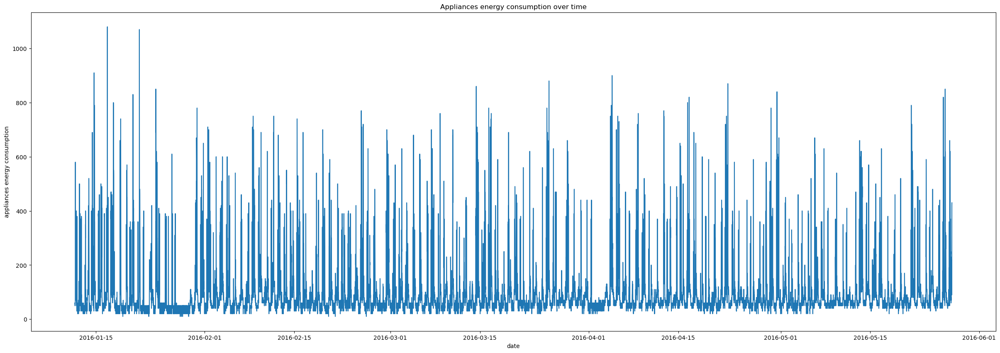

In [11]:
# visualise target
import warnings
warnings.filterwarnings("ignore")

plt.figure(figsize=(30, 10))
sns.lineplot(data['appliance'])
plt.title('Appliances energy consumption over time')
plt.xlabel('date')
plt.ylabel('appliances energy consumption')
plt.show()

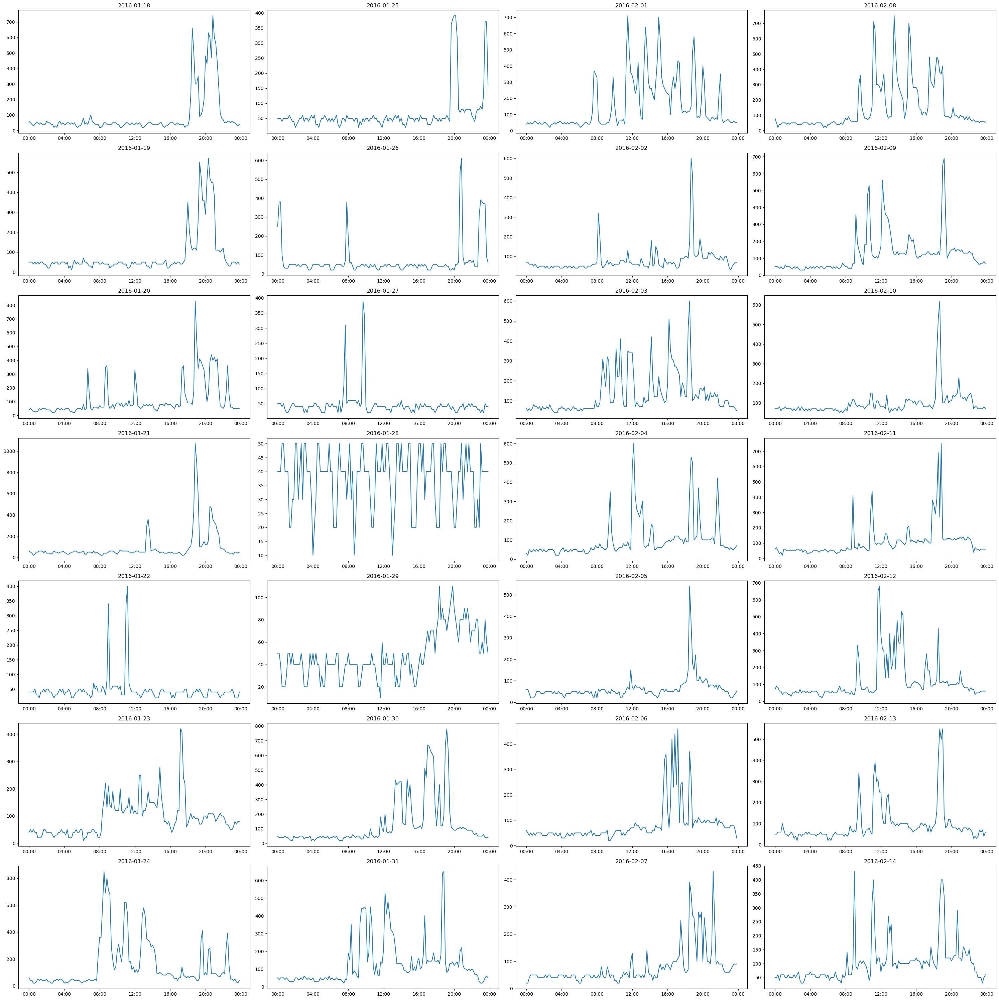

In [12]:
# have a closer look for 4 weeks data
start_date = '2016-01-18'
end_date = pd.to_datetime(start_date) + pd.DateOffset(days=27)

fig, axes = plt.subplots(nrows=7, ncols=4, figsize=(30, 30))

for i, day in enumerate(pd.date_range(start=start_date, end=end_date)):
    daily_data = data.loc[day.strftime('%Y-%m-%d')]
    ax = axes[i % 7, i // 7]
    ax.plot(daily_data.index, daily_data['appliance'])
    ax.xaxis.set_major_locator(mdates.HourLocator(interval=4))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    ax.set_title(day.strftime('%Y-%m-%d'))

plt.tight_layout()
plt.show()

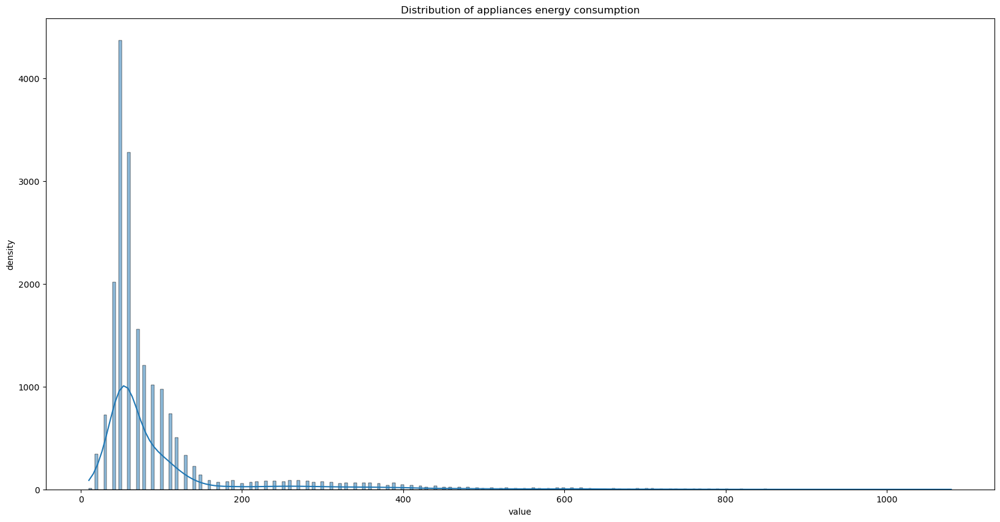

In [13]:
# distribution of target
plt.figure(figsize=(20, 10))
sns.histplot(data['appliance'], kde=True)
plt.title('Distribution of appliances energy consumption')
plt.xlabel('value')
plt.ylabel('density')
plt.show()

<Figure size 3000x3000 with 0 Axes>

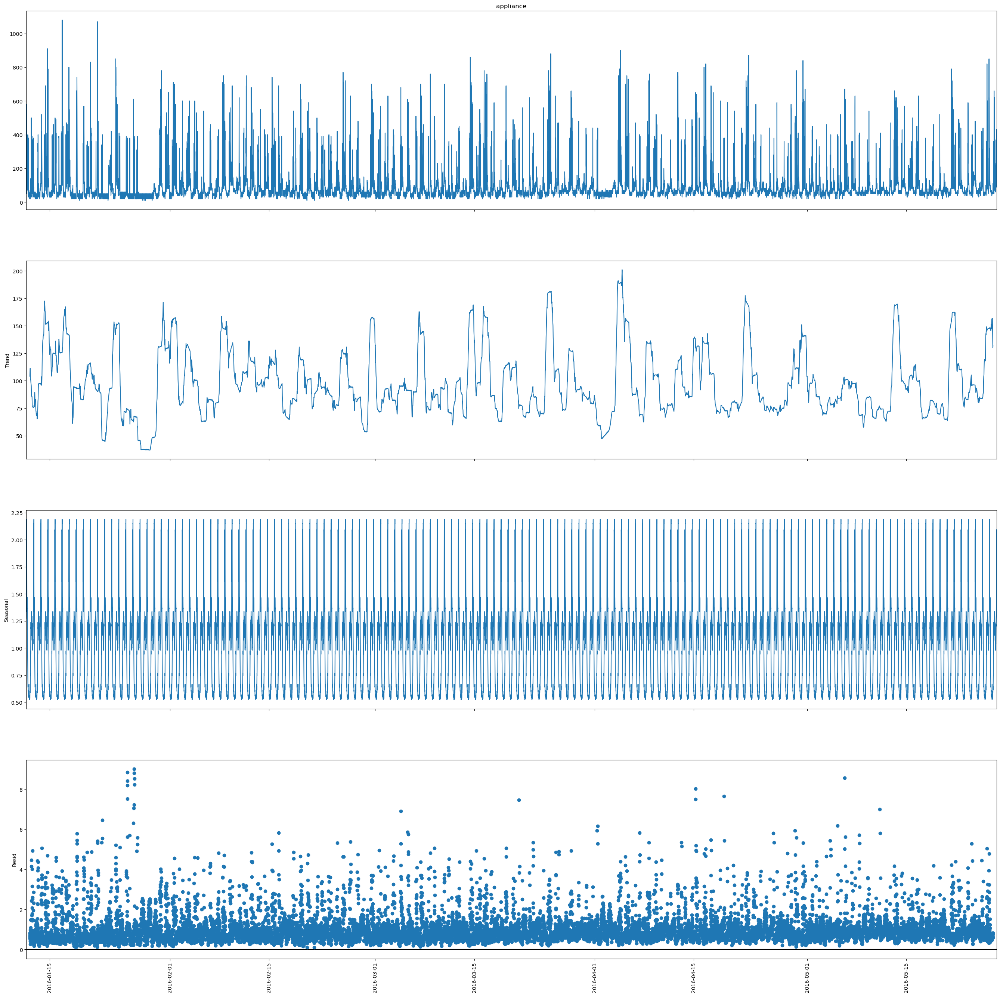

In [14]:
# too much noise in data appliance, decompose to seperate trend, seasonility, and noise [4, p. 401-402]
plt.figure(figsize=(30, 30))
dcp_appliance = sm.tsa.seasonal_decompose(data['appliance'], model='multiplicative', period=144)
dcp_appliance.plot()
plt.gcf().set_size_inches(30, 30)
plt.xticks(rotation=90)
plt.show()

##### 2.2.2 Sensor features visualisation

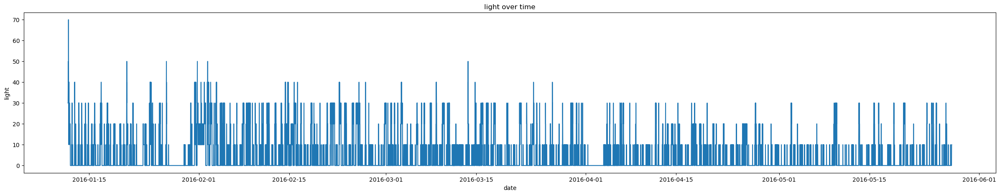

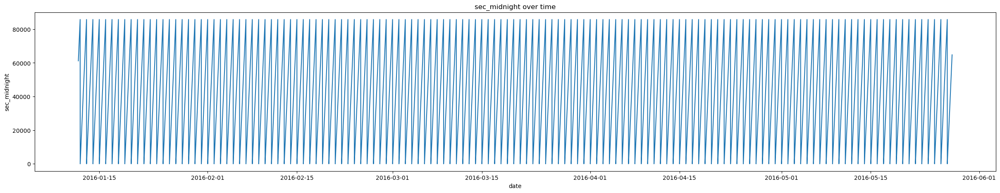

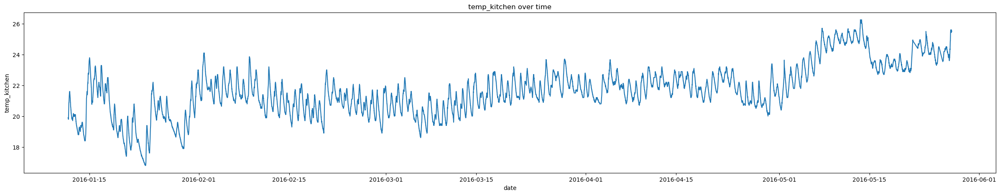

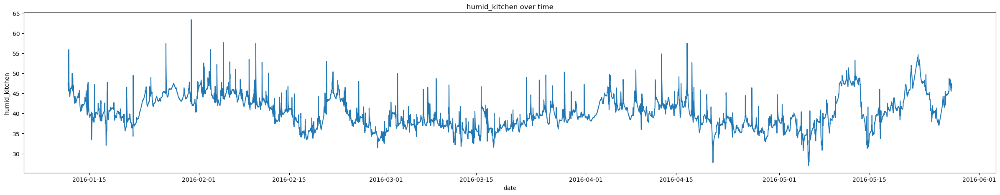

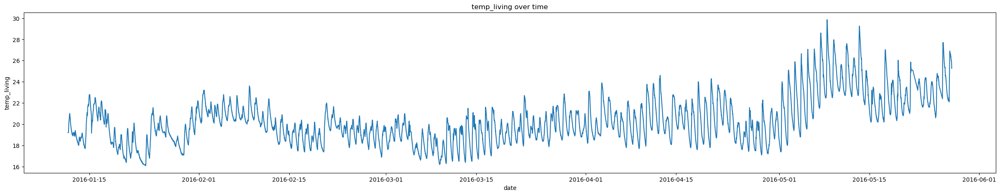

...

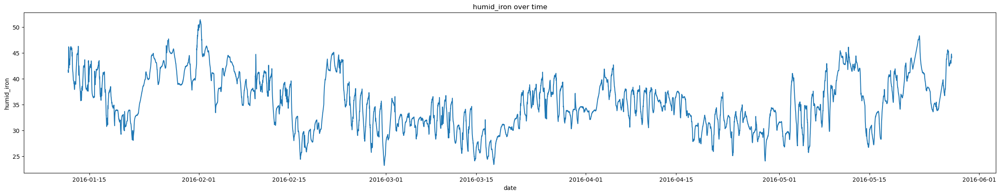

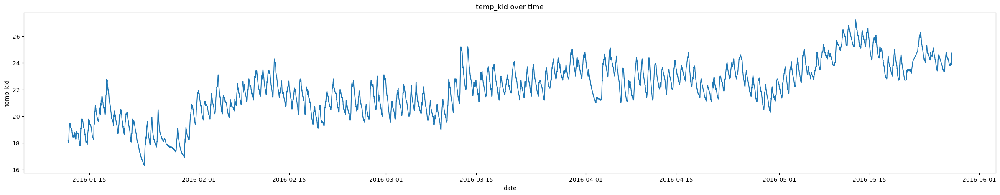

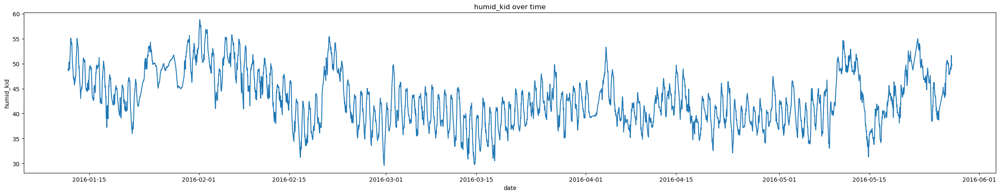

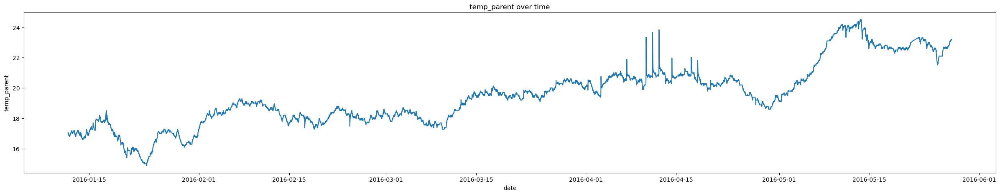

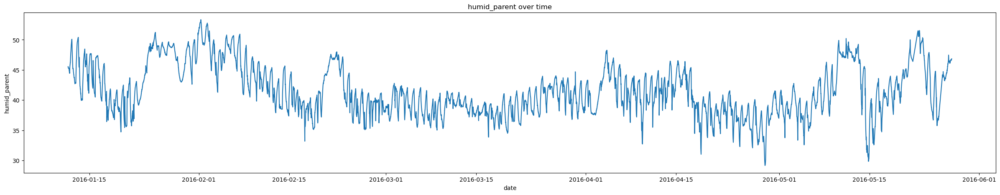

In [15]:
# visualise sensor features
for feature in sensor:
    plt.figure(figsize=(30, 5))
    sns.lineplot(data[feature])
    plt.title(f'{feature} over time')
    plt.xlabel('date')
    plt.ylabel(f'{feature}')
    plt.show()

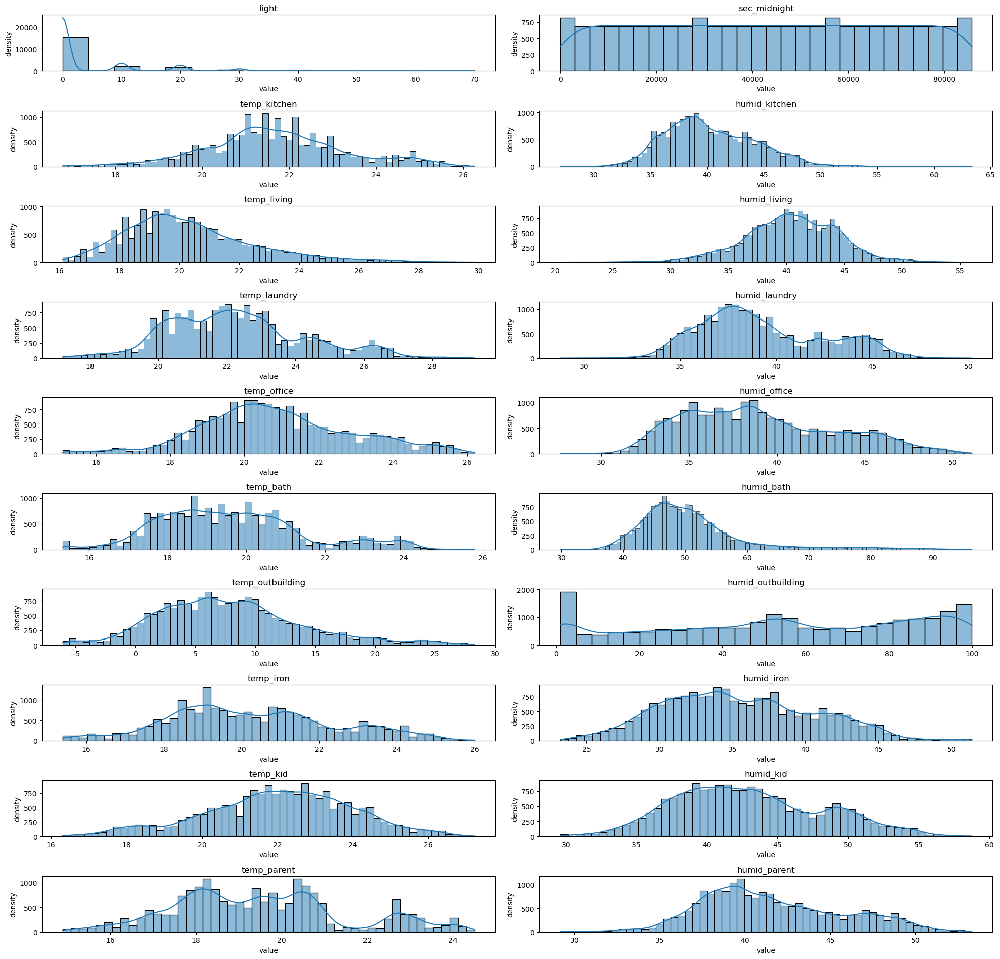

In [16]:
# distribution of sensor features
fig, axs = plt.subplots(10, 2, figsize=(20,20))
axs = axs.flatten()

for ax, feature in zip(axs, sensor):
    sns.histplot(data[feature], kde=True, ax=ax)
    ax.set_title(feature)
    ax.set_xlabel('value')
    ax.set_ylabel('density')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

* Check relationship between target and sensor features:

In [17]:
# define trend line
def plot_trend(x, y, **kwargs):
    coeffs = np.polyfit(x, y, 1)
    plt.plot(x, coeffs[0] * x + coeffs[1], color='red')

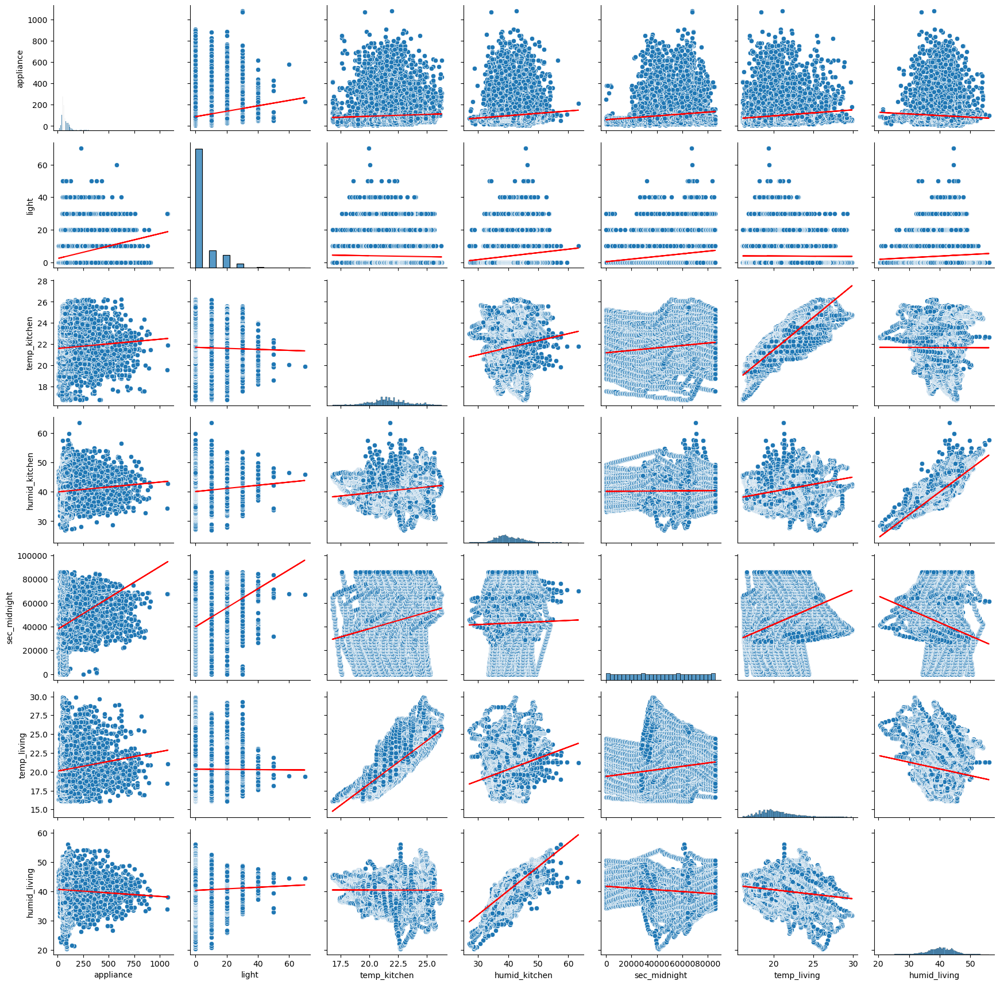

In [18]:
# sensor features too large, we divided into different plots
sensor_appliance1 = data[['appliance', 'light', 'temp_kitchen', 'humid_kitchen', 'sec_midnight',
                          'temp_living', 'humid_living']].copy()

g = sns.PairGrid(sensor_appliance1)
g.map_offdiag(sns.scatterplot)
g.map_offdiag(plot_trend)
g.map_diag(sns.histplot)
plt.show()

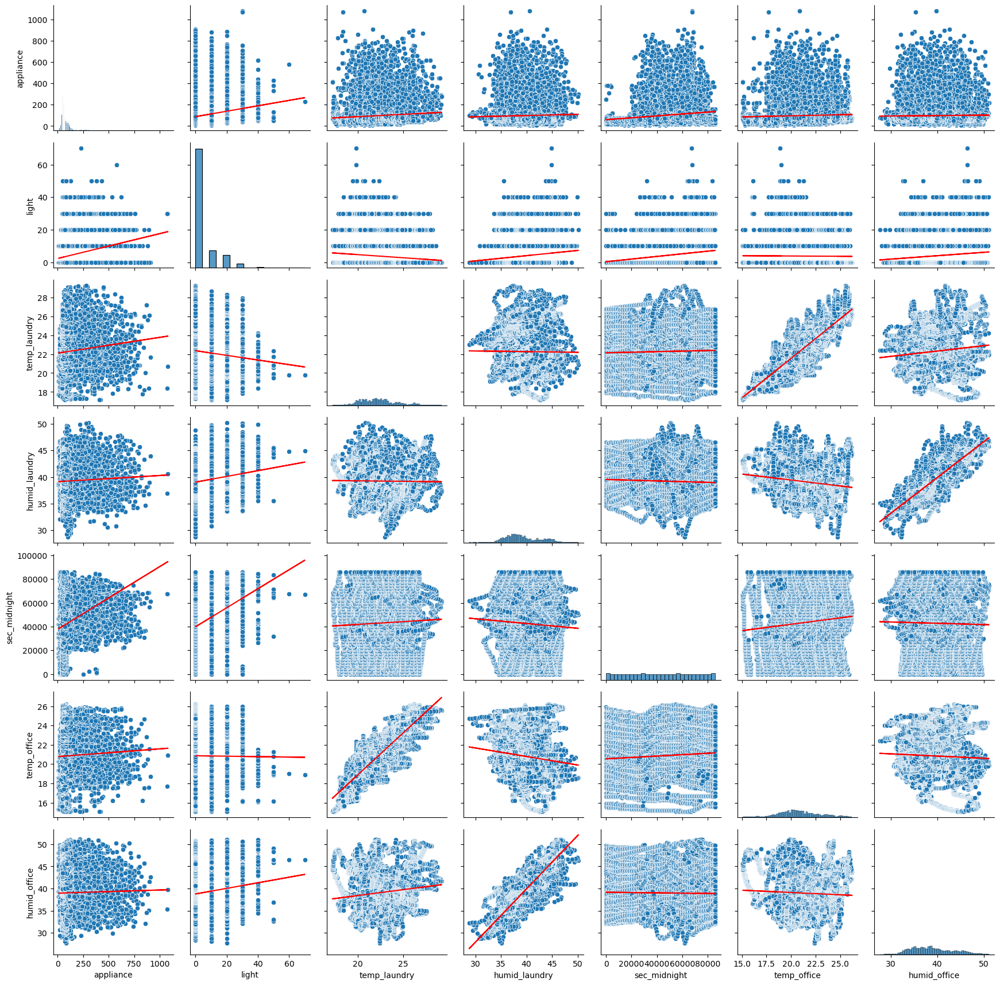

In [19]:
# sensor features too large, we divided into different plots
sensor_appliance2 = data[['appliance', 'light', 'temp_laundry', 'humid_laundry',
                          'sec_midnight', 'temp_office', 'humid_office']].copy()

g = sns.PairGrid(sensor_appliance2)
g.map_offdiag(sns.scatterplot)
g.map_offdiag(plot_trend)
g.map_diag(sns.histplot)
plt.show()

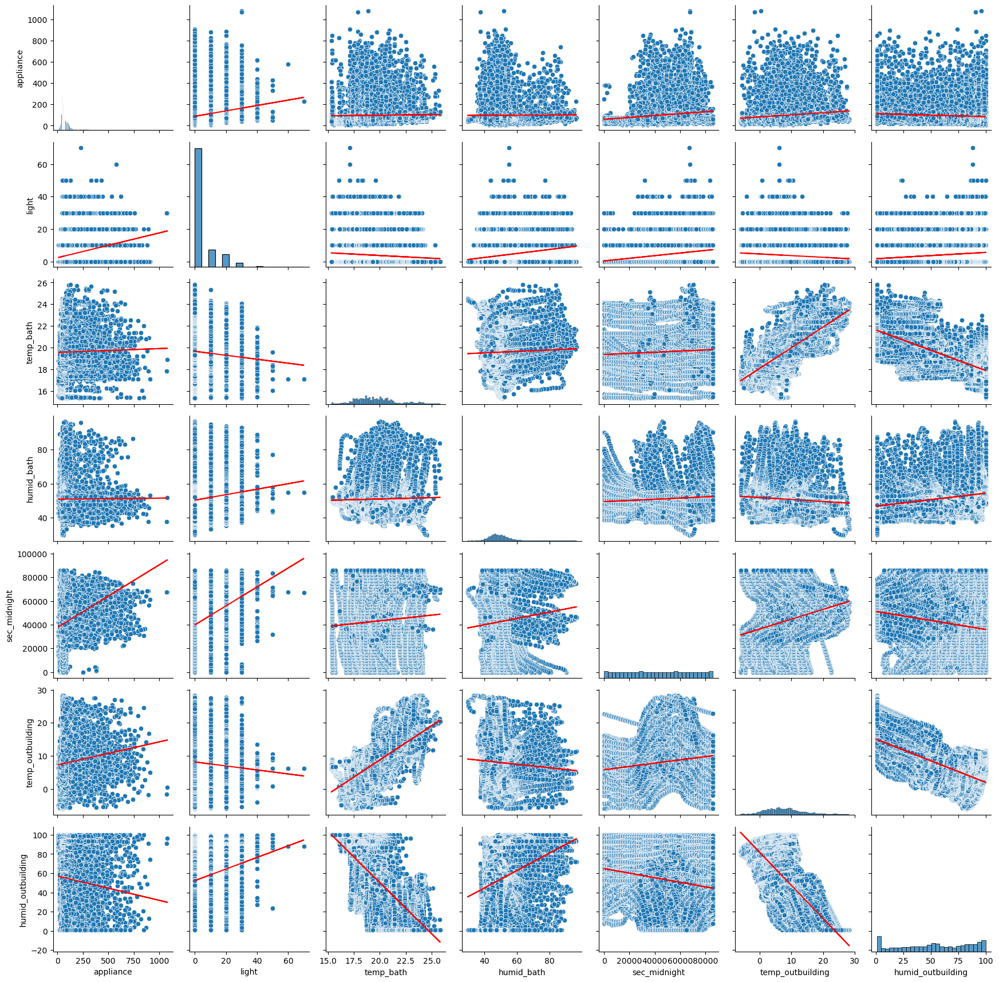

In [20]:
# sensor features too large, we divided into different plots
sensor_appliance3 = data[['appliance', 'light', 'temp_bath', 'humid_bath',
                          'sec_midnight', 'temp_outbuilding', 'humid_outbuilding']].copy()

g = sns.PairGrid(sensor_appliance3)
g.map_offdiag(sns.scatterplot)
g.map_offdiag(plot_trend)
g.map_diag(sns.histplot)
plt.show()

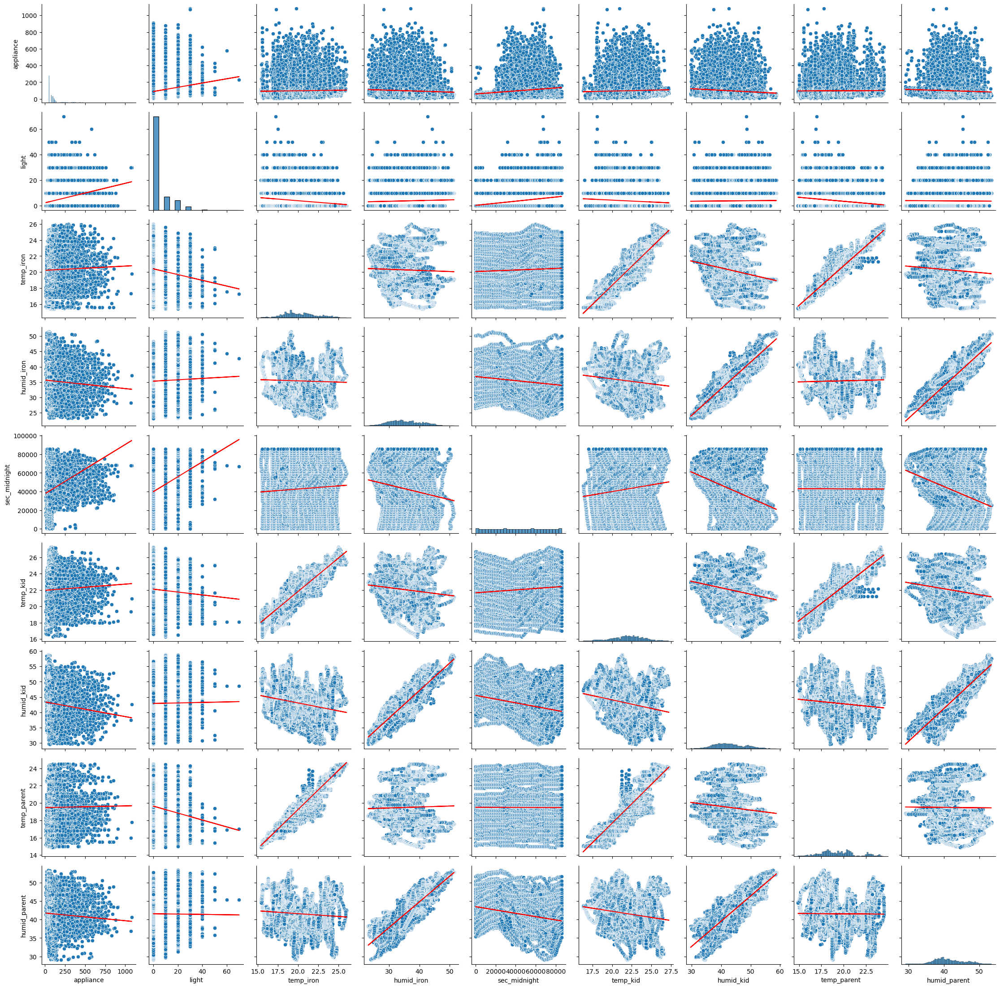

In [21]:
# sensor features too large, we divided into different plots
sensor_appliance4 = data[['appliance', 'light', 'temp_iron', 'humid_iron', 'sec_midnight',
                          'temp_kid', 'humid_kid', 'temp_parent', 'humid_parent']].copy()

g = sns.PairGrid(sensor_appliance4)
g.map_offdiag(sns.scatterplot)
g.map_offdiag(plot_trend)
g.map_diag(sns.histplot)
plt.show()

##### 2.2.3 Weather features visualisation

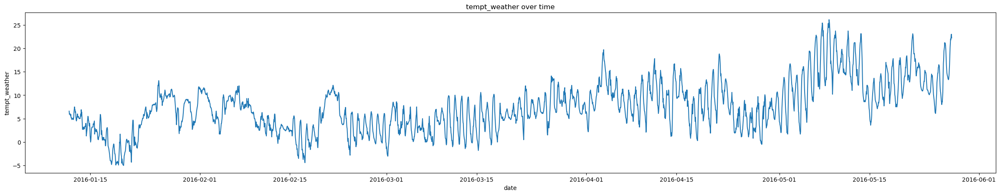

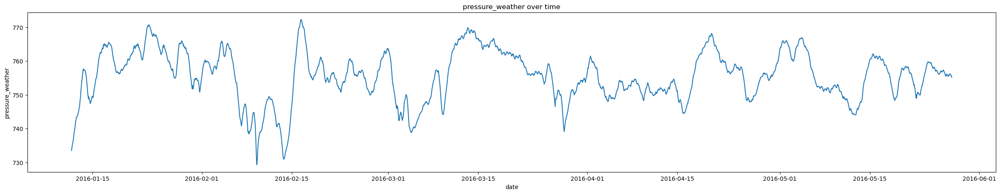

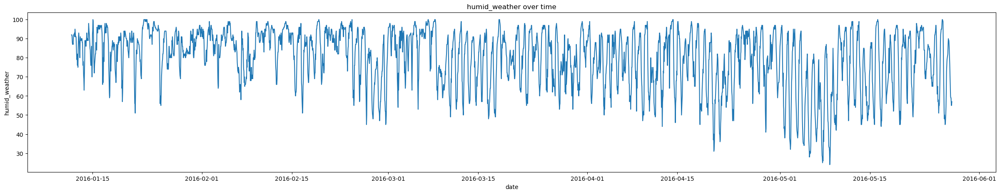

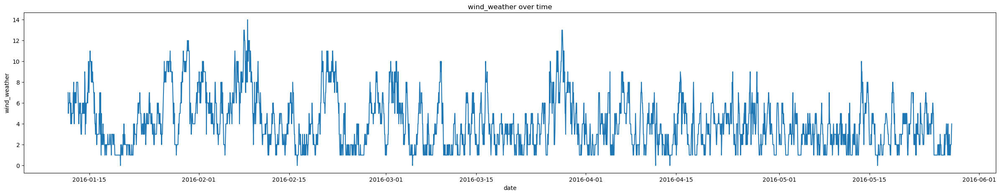

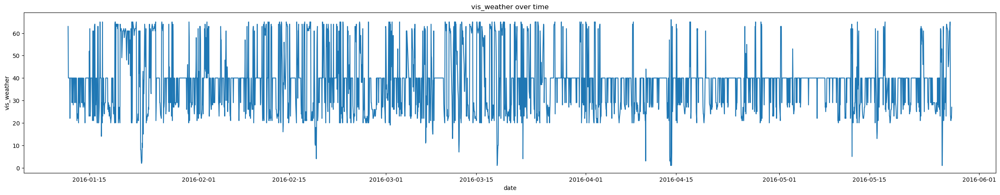

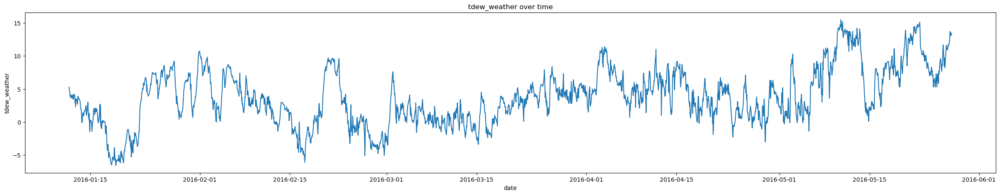

In [22]:
# visualise weather features
for feature in weather:
    plt.figure(figsize=(30, 5))
    sns.lineplot(data[feature])
    plt.title(f'{feature} over time')
    plt.xlabel('date')
    plt.ylabel(f'{feature}')
    plt.show()

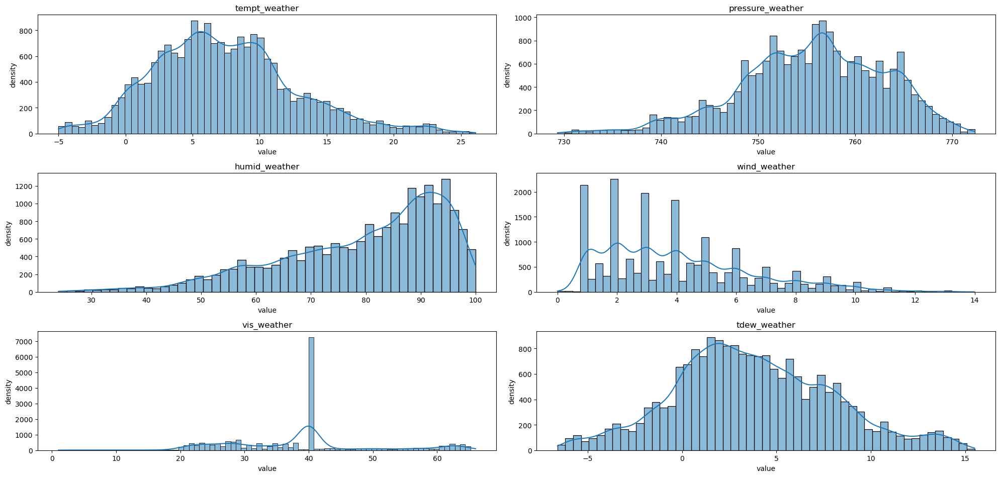

In [23]:
# distribution of weather features
fig, axs = plt.subplots(3, 2, figsize=(20,10))
axs = axs.flatten()

for ax, feature in zip(axs, weather):
    sns.histplot(data[feature], kde=True, ax=ax)
    ax.set_title(feature)
    ax.set_xlabel('value')
    ax.set_ylabel('density')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

* Check relationship between target and weather features:

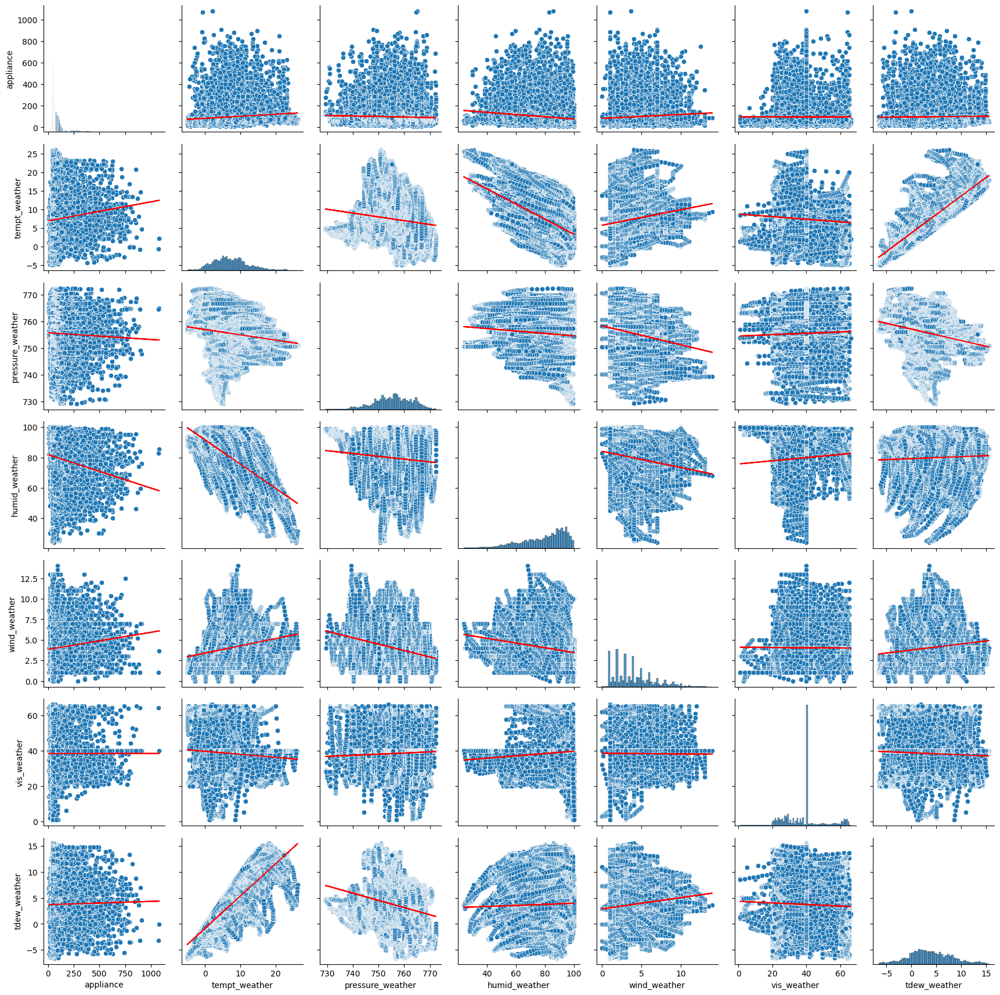

In [24]:
# weather features
weather_appliance = data[['appliance', 'tempt_weather', 'pressure_weather', 'humid_weather',
                          'wind_weather', 'vis_weather', 'tdew_weather']].copy()

g = sns.PairGrid(weather_appliance)
g.map_offdiag(sns.scatterplot)
g.map_offdiag(plot_trend)
g.map_diag(sns.histplot)
plt.show()

#### 2.3 Check correlation

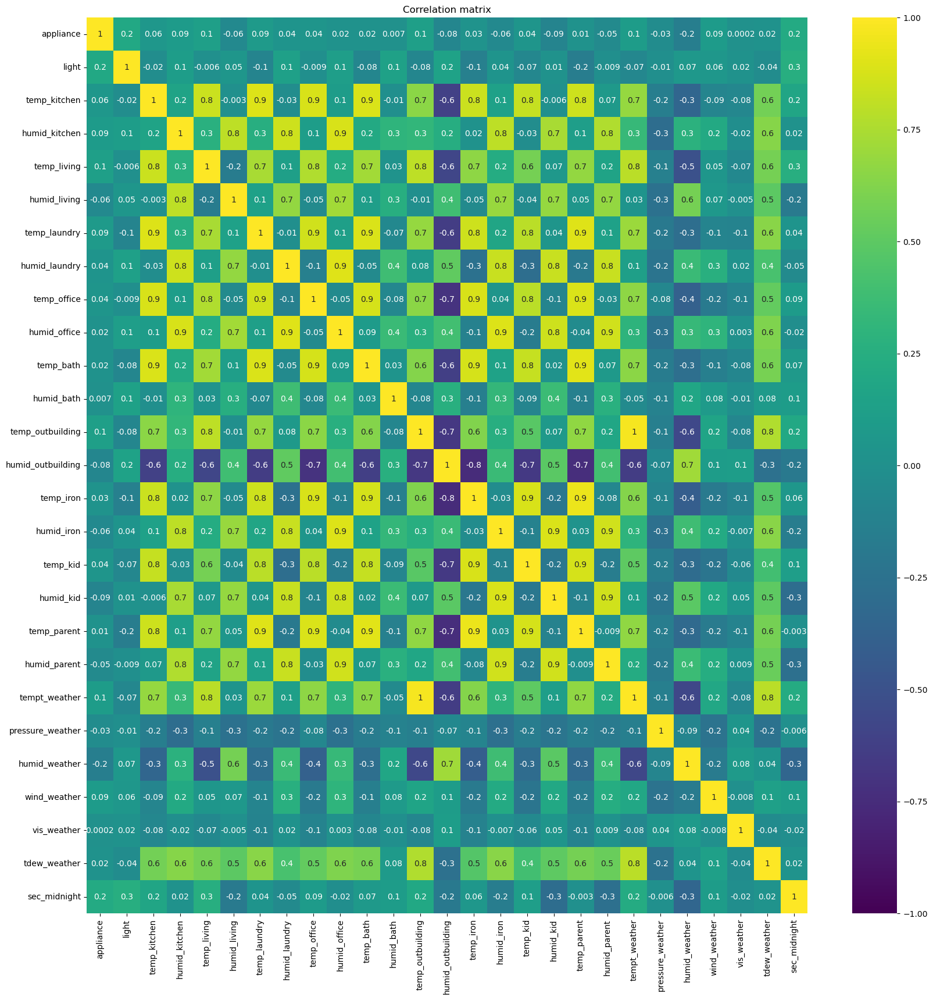

In [25]:
plt.figure(figsize=(20, 20))
corr = data.corr(numeric_only=True)
matrix = np.triu(corr)
sns.heatmap(corr, vmax=1.0, vmin=-1.0, fmt='.1g', annot=True, cmap='viridis')
plt.title('Correlation matrix')
plt.show()

#### 2.4 Analyse discussion

##### 2.4.1 Relationship between variables

From 2.3, there are some observations:
- Appliances energy consumption has a high variability. When looking at loser data within 1 month, it seems that it is not seasonal by the day of the week but by hourly and daily. It appears to be affected by the previous day's consumption. When decompositing with multiplicative method, no trend obviously, but have uniform seasonal change. Non-uniform noise that represents outliers and missing values.
- Light energy consumption is also quite similar to appliance energy consumption but has less variability. All the sensor features appears to have seasonal data by daily.
- All features, including sensor and weather appears non-uniform distribution -> need scaled
- It seems like the appliance energy consumption increases if light energy consumption, and temperature in all rooms increase. Energy consumptions increase from midnight the previous day to the next midnight. There is no strong evidence to show any relationship between humidity, weather features and energy consumption.

##### 2.4.2 Model selection

We'll use 3 different methods for time series forecasting as [4, p. 4] to compare the results:
- Smoothing based method: Seasonal Naive as a baseline
- Regression based method: AutoARIMA [5]
- Machine learning based method: LSTM [5]

##### 2.4.3 Feature selections and Pre-processing steps

With [1, pp. 92-93], we've known that all features have large correlation with each features and helps to reduce RMSE of appliances energy consumption prediction. However, many features have small correlation with appliances energy consumption, we'll use PCA to reduce the dimension for better forecasting models. [7]

### 3. Implement prediction models

#### 3.1 Pre-processing

In [26]:
# create data for modelling
model_data = data.copy()
model_data.head()

,appliance,light,temp_kitchen,humid_kitchen,temp_living,humid_living,temp_laundry,humid_laundry,temp_office,humid_office,...,humid_kid,temp_parent,humid_parent,tempt_weather,pressure_weather,humid_weather,wind_weather,vis_weather,tdew_weather,sec_midnight
date,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00+00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,61200
2016-01-11 17:10:00+00:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,61800
2016-01-11 17:20:00+00:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,62400
2016-01-11 17:30:00+00:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,63000
2016-01-11 17:40:00+00:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,63600


In [27]:
model_data.columns

Index(['appliance', 'light', 'temp_kitchen', 'humid_kitchen', 'temp_living',
       'humid_living', 'temp_laundry', 'humid_laundry', 'temp_office',
       'humid_office', 'temp_bath', 'humid_bath', 'temp_outbuilding',
       'humid_outbuilding', 'temp_iron', 'humid_iron', 'temp_kid', 'humid_kid',
       'temp_parent', 'humid_parent', 'tempt_weather', 'pressure_weather',
       'humid_weather', 'wind_weather', 'vis_weather', 'tdew_weather',
       'sec_midnight'],
      dtype='object')

In [28]:
# scale data for pca
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

features = ['light', 'temp_kitchen', 'humid_kitchen', 'temp_living',
       'humid_living', 'temp_laundry', 'humid_laundry', 'temp_office',
       'humid_office', 'temp_bath', 'humid_bath', 'temp_outbuilding',
       'humid_outbuilding', 'temp_iron', 'humid_iron', 'temp_kid', 'humid_kid',
       'temp_parent', 'humid_parent', 'tempt_weather', 'pressure_weather',
       'humid_weather', 'wind_weather', 'vis_weather', 'tdew_weather',
       'sec_midnight']

feature = model_data[features]
target = model_data['appliance']

scaler = StandardScaler()
feature_scaled = scaler.fit_transform(feature)
feature_scaled.shape

(19735, 26)

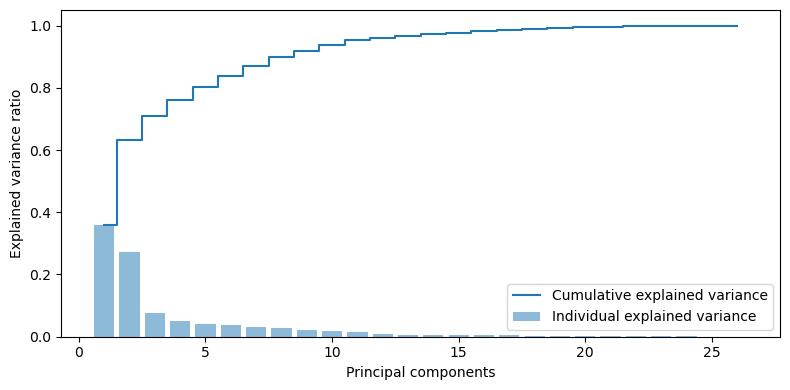

In [29]:
# check how many components should use for pca
pca = PCA()
feature_pca = pca.fit_transform(feature_scaled)

explained_variance = pca.explained_variance_ratio_

plt.figure(figsize=(8, 4))
plt.bar(range(1, len(explained_variance)+1), explained_variance, alpha=0.5, align='center',
        label='Individual explained variance')
plt.step(range(1, len(explained_variance)+1), np.cumsum(explained_variance), where='mid',
         label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal components')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [30]:
# we can see there's none explaination from the components 12, suggest have 11 components ~ 11 features
pca = PCA(n_components=11)
feature_reduced = pca.fit_transform(feature_scaled)
feature_reduced.shape

(19735, 11)

In [31]:
# merge data together to train model
pca_col = ['PCA1', 'PCA2', 'PCA3', 'PCA4','PCA5', 'PCA6','PCA7', 'PCA8','PCA9', 'PCA10', 'PCA11']
df_pca = pd.DataFrame(feature_reduced, columns=pca_col, index=model_data.index)

df_pca['appliance'] = target
                       
final_data = df_pca

final_data.describe()

,PCA1,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,PCA11,appliance
count,19735.000000,1.973500e+04,1.973500e+04,1.973500e+04,1.973500e+04,1.973500e+04,1.973500e+04,1.973500e+04,1.973500e+04,1.973500e+04,1.973500e+04,19735.000000
mean,0.000000,1.152134e-17,2.304268e-17,-2.304268e-17,-1.152134e-17,2.304268e-17,-5.760671e-18,-2.880335e-18,6.336738e-17,-4.824562e-17,-2.304268e-17,97.694958
std,3.056950,2.662081e+00,1.412408e+00,1.163478e+00,1.023178e+00,9.889328e-01,9.178525e-01,8.345308e-01,7.466408e-01,6.997467e-01,6.105242e-01,102.524891
min,-6.828388,-6.970744e+00,-3.491848e+00,-2.589856e+00,-3.484948e+00,-3.490086e+00,-4.222105e+00,-2.614079e+00,-2.300641e+00,-2.637617e+00,-2.415395e+00,10.000000
25%,-2.185861,-2.000712e+00,-1.123086e+00,-7.623705e-01,-6.924520e-01,-6.789331e-01,-4.792773e-01,-5.768780e-01,-5.034695e-01,-4.482365e-01,-3.999050e-01,50.000000
50%,-0.465450,3.869719e-01,1.437731e-01,-2.864891e-01,1.400935e-02,-1.626084e-02,-9.237270e-02,2.999405e-03,4.391792e-02,-3.392166e-02,-9.833825e-03,60.000000
75%,1.785984,1.940998e+00,1.056798e+00,5.427464e-01,6.841799e-01,6.300275e-01,4.008055e-01,5.656004e-01,5.101629e-01,4.262045e-01,3.890267e-01,100.000000
max,9.048071,7.196335e+00,3.880941e+00,5.785400e+00,3.698356e+00,3.645304e+00,4.425286e+00,3.714766e+00,2.625079e+00,2.764790e+00,2.598727e+00,1080.000000


#### 3.2 Define and train seasonal Naive model

In [32]:
# our data is 10min interval, to predict 1 week data, we split data points of 24 x 6 * 7 = 1008 to predict the next week
split_point = 1008
train_snaive = final_data.iloc[:-split_point]
test_snaive = final_data.iloc[-split_point:]

# define seasonal naive model
snaive_forecast = final_data['appliance'].shift(1008).tail(split_point)
snaive_forecast

date
2016-05-20 18:10:00+00:00    490.0
2016-05-20 18:20:00+00:00    280.0
2016-05-20 18:30:00+00:00    280.0
2016-05-20 18:40:00+00:00    310.0
2016-05-20 18:50:00+00:00    280.0
                             ...  
2016-05-27 17:20:00+00:00     80.0
2016-05-27 17:30:00+00:00     70.0
2016-05-27 17:40:00+00:00     80.0
2016-05-27 17:50:00+00:00     70.0
2016-05-27 18:00:00+00:00     90.0
Name: appliance, Length: 1008, dtype: float64

#### 3.3 Define and train autoARIMA model

In [33]:
# split data into train and validation sets
import pmdarima
from pmdarima import auto_arima

train_arima, test_arima = final_data.iloc[:int(0.8 * len(final_data))], final_data.iloc[int(0.8 * len(final_data)):]

In [34]:
#decompose seasonal by using Fourier
_, ff_X = FourierFeaturizer(144, k=6).fit_transform(train_arima['appliance'])

new_feature = ['PCA1', 'PCA2', 'PCA3', 'PCA4', 'PCA5', 'PCA6',
               'PCA7', 'PCA8', 'PCA9', 'PCA10', 'PCA11']

exog = pd.concat([ff_X, train_arima[new_feature].reset_index(drop=True)], axis=1)
exog

,FOURIER_S144-0,FOURIER_C144-0,FOURIER_S144-1,FOURIER_C144-1,FOURIER_S144-2,FOURIER_C144-2,FOURIER_S144-3,FOURIER_C144-3,FOURIER_S144-4,FOURIER_C144-4,...,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,PCA11
0,0.043619,0.999048,0.087156,0.996195,0.130526,0.991445,0.173648,0.984808,0.216440,0.976296,...,-4.584734,2.267430,2.028781,-0.495716,2.864711,-1.638600,0.690243,-0.781087,-1.454360,0.610827
1,0.087156,0.996195,0.173648,0.984808,0.258819,0.965926,0.342020,0.939693,0.422618,0.906308,...,-4.512067,2.211060,2.060636,-0.613119,2.560064,-1.647138,0.690984,-0.887842,-1.450524,0.539807
2,0.130526,0.991445,0.258819,0.965926,0.382683,0.923880,0.500000,0.866025,0.608761,0.793353,...,-4.424334,2.164937,2.097534,-0.736862,2.257623,-1.675274,0.662663,-0.989287,-1.450704,0.526745
3,0.173648,0.984808,0.342020,0.939693,0.500000,0.866025,0.642788,0.766044,0.766044,0.642788,...,-4.395544,2.333612,2.891894,-0.721332,1.958864,-2.313756,1.302523,-1.056990,-1.773713,0.565939
4,0.216440,0.976296,0.422618,0.906308,0.608761,0.793353,0.766044,0.642788,0.887011,0.461749,...,-4.373549,2.269404,2.945647,-0.844331,1.654080,-2.352275,1.255474,-1.144801,-1.774929,0.592575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15783,-0.642772,-0.766057,0.984801,0.173688,-0.865997,0.500050,0.342095,-0.939665,0.342037,0.939687,...,0.549532,-1.523905,-0.820407,0.510085,-0.076017,-0.546337,-0.400061,-0.432233,-0.494858,-0.794005
15784,-0.675575,-0.737291,0.996191,0.087196,-0.793318,0.608807,0.173727,-0.984794,0.537314,0.843382,...,0.527817,-1.479021,-0.819717,0.524414,-0.081250,-0.577666,-0.451219,-0.417823,-0.511003,-0.786366
15785,-0.707093,-0.707121,1.000000,0.000040,-0.707066,0.707147,0.000080,-1.000000,0.707119,0.707094,...,0.495588,-1.400451,-0.832804,0.558164,-0.098041,-0.600981,-0.487431,-0.422496,-0.549756,-0.821596
15786,-0.737264,-0.675605,0.996198,-0.087116,-0.608716,0.793388,-0.173569,-0.984822,0.843401,0.537285,...,0.524051,-1.340333,-0.847591,0.580022,-0.102203,-0.631907,-0.507281,-0.457407,-0.542587,-0.824544


In [35]:
arima_model = auto_arima(train_arima['appliance'], exogenous=exog,
                         start_p=1, start_q=1, max_p=3, max_q=3,
                         m=144, start_P=0, seasonal=False, d=1, D=1,
                         trace=True, error_action='ignore', suppress_warnings=True)

print(arima_model.summary())

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=178368.848, Time=3.71 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=180426.307, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=180382.539, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=180335.432, Time=1.65 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=180424.308, Time=0.13 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=178013.288, Time=3.13 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=179432.157, Time=0.56 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=177975.486, Time=9.34 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=179115.377, Time=0.77 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=177977.362, Time=14.81 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=177977.844, Time=8.00 sec
 ARIMA(3,1,1)(0,0,0)[0]             : AIC=177973.486, Time=1.48 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=178011.289, Time=0.76 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=179113.378, Time=0.32 sec
 ARI

#### 3.4 Define and train LSTM model

Follow code instruction of [6]:

In [36]:
# split data into train and validation sets
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

train_lstm, test_lstm = final_data.iloc[:int(0.8 * len(final_data))], final_data.iloc[int(0.8 * len(final_data)):]


In [37]:
# convert to x_train, y_train
x_train, y_train = [], []
for i in range(144, len(train_lstm)):
    x_train.append(train_lstm.iloc[i-144:i, 0].values)
    y_train.append(train_lstm.iloc[i, 0])

x_train, y_train = np.array(x_train), np.array(y_train)

In [38]:
# define model
lstm_model = Sequential()
lstm_model.add(LSTM(units=64, return_sequences=True, dropout=0.15, recurrent_dropout=0.25,
                    input_shape=(x_train.shape[1],1)))
lstm_model.add(LSTM(units=64))
lstm_model.add(Dense(1))
lstm_model.compile(loss='mean_squared_error', optimizer='adam')
lstm_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 144, 64)        │        16,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 64)             │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 49,985 (195.25 KB)

 Trainable params: 49,985 (195.25 KB)

 Non-trainable params: 0 (0.00 B)

In [40]:
# Train data
lstm_model.fit(x_train, y_train, epochs=20, batch_size=32, verbose=2)

Epoch 1/20


489/489 - 27s - 55ms/step - loss: 0.6691
Epoch 2/20
489/489 - 27s - 56ms/step - loss: 0.6282
Epoch 3/20
489/489 - 28s - 57ms/step - loss: 0.6861
Epoch 4/20
489/489 - 28s - 57ms/step - loss: 0.6535
Epoch 5/20
489/489 - 29s - 59ms/step - loss: 0.6882
Epoch 6/20
489/489 - 28s - 56ms/step - loss: 0.6542
Epoch 7/20
489/489 - 27s - 54ms/step - loss: 0.6610
Epoch 8/20
489/489 - 28s - 57ms/step - loss: 0.6587
Epoch 9/20
489/489 - 27s - 56ms/step - loss: 0.6899
Epoch 10/20
489/489 - 27s - 55ms/step - loss: 0.6465
Epoch 11/20
489/489 - 27s - 56ms/step - loss: 0.6838
Epoch 12/20
489/489 - 28s - 57ms/step - loss: 0.6578
Epoch 13/20
489/489 - 27s - 56ms/step - loss: 0.6807
Epoch 14/20
489/489 - 27s - 56ms/step - loss: 0.6504
Epoch 15/20
489/489 - 27s - 55ms/step - loss: 0.6762
Epoch 16/20
489/489 - 27s - 56ms/step - loss: 0.6975
Epoch 17/20
489/489 - 27s - 55ms/step - loss: 0.6582
Epoch 18/20
489/489 - 27s - 56ms/step - loss: 0.6828
Epoch 19/20
489/489 - 28s - 56ms/step - loss: 0.6692
Epoch 20/20
4

### 4. Test prediction models

#### 4.1 Test seasonal Naive model

In [41]:
test_snaive['snaive_forecast'] = snaive_forecast[:len(test_snaive)]

snaive_mae = mean_absolute_error(test_snaive['appliance'], test_snaive['snaive_forecast'])
snaive_rmse = root_mean_squared_error(test_snaive['appliance'], test_snaive['snaive_forecast'])

print(f"Mean Absolute Error of Seasonal Naive: {snaive_mae}")
print(f"Root Mean Squared Error of Season Naive: {snaive_rmse}")

Mean Absolute Error of Seasonal Naive: 61.68650793650794
Root Mean Squared Error of Season Naive: 124.08554396956248


#### 4.2 Test autoARIMA model

In [42]:
_, ff_test = FourierFeaturizer(6 * 24, k=6).fit_transform(test_arima['appliance'])
ff_test

,FOURIER_S144-0,FOURIER_C144-0,FOURIER_S144-1,FOURIER_C144-1,FOURIER_S144-2,FOURIER_C144-2,FOURIER_S144-3,FOURIER_C144-3,FOURIER_S144-4,FOURIER_C144-4,FOURIER_S144-5,FOURIER_C144-5
0,0.043619,0.999048,0.087156,0.996195,0.130526,0.991445,0.173648,0.984808,0.216440,0.976296,0.258819,0.965926
1,0.087156,0.996195,0.173648,0.984808,0.258819,0.965926,0.342020,0.939693,0.422618,0.906308,0.500000,0.866025
2,0.130526,0.991445,0.258819,0.965926,0.382683,0.923880,0.500000,0.866025,0.608761,0.793353,0.707107,0.707107
3,0.173648,0.984808,0.342020,0.939693,0.500000,0.866025,0.642788,0.766044,0.766044,0.642788,0.866025,0.500000
4,0.216440,0.976296,0.422618,0.906308,0.608761,0.793353,0.766044,0.642788,0.887011,0.461749,0.965926,0.258819
...,...,...,...,...,...,...,...,...,...,...,...,...
3942,0.675594,-0.737274,-0.996196,0.087146,0.793362,0.608750,-0.173628,-0.984811,-0.537296,0.843394,0.965918,-0.258847
3943,0.642791,-0.766041,-0.984809,0.173638,0.866033,0.499988,-0.342001,-0.939699,-0.342016,0.939694,0.866011,-0.500025
3944,0.608765,-0.793350,-0.965928,0.258809,0.923885,0.382670,-0.499983,-0.866035,-0.130522,0.991445,0.707086,-0.707127
3945,0.573581,-0.819149,-0.939696,0.342011,0.965930,0.258805,-0.642772,-0.766057,0.087160,0.996194,0.499975,-0.866040


In [43]:
exog_test = pd.concat([ff_test, test_arima[new_feature].reset_index(drop=True)], axis=1)
exog_test

,FOURIER_S144-0,FOURIER_C144-0,FOURIER_S144-1,FOURIER_C144-1,FOURIER_S144-2,FOURIER_C144-2,FOURIER_S144-3,FOURIER_C144-3,FOURIER_S144-4,FOURIER_C144-4,...,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,PCA11
0,0.043619,0.999048,0.087156,0.996195,0.130526,0.991445,0.173648,0.984808,0.216440,0.976296,...,0.608137,-1.204359,-0.858059,0.600859,-0.116013,-0.661672,-0.569872,-0.453323,-0.570276,-0.724249
1,0.087156,0.996195,0.173648,0.984808,0.258819,0.965926,0.342020,0.939693,0.422618,0.906308,...,0.650529,-1.104861,-0.858436,0.622264,-0.135333,-0.622998,-0.575063,-0.463900,-0.611276,-0.701582
2,0.130526,0.991445,0.258819,0.965926,0.382683,0.923880,0.500000,0.866025,0.608761,0.793353,...,0.689496,-1.001275,-0.871682,0.647750,-0.156291,-0.597857,-0.581361,-0.481467,-0.643841,-0.666822
3,0.173648,0.984808,0.342020,0.939693,0.500000,0.866025,0.642788,0.766044,0.766044,0.642788,...,0.715758,-0.684631,-0.131879,0.818357,-0.169749,-1.159206,0.114460,-0.489575,-0.972849,-0.582185
4,0.216440,0.976296,0.422618,0.906308,0.608761,0.793353,0.766044,0.642788,0.887011,0.461749,...,0.810913,-0.763136,-0.945739,0.724204,-0.197998,-0.520005,-0.531384,-0.593469,-0.713800,-0.639889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3942,0.675594,-0.737274,-0.996196,0.087146,0.793362,0.608750,-0.173628,-0.984811,-0.537296,0.843394,...,-2.607310,1.098305,-0.542532,0.422911,-1.433150,0.181687,-0.398155,-0.526756,-0.117342,0.004837
3943,0.642791,-0.766041,-0.984809,0.173638,0.866033,0.499988,-0.342001,-0.939699,-0.342016,0.939694,...,-2.585757,1.083144,-0.521041,0.415284,-1.351469,0.171883,-0.407689,-0.447852,-0.063877,0.023987
3944,0.608765,-0.793350,-0.965928,0.258809,0.923885,0.382670,-0.499983,-0.866035,-0.130522,0.991445,...,-2.741860,1.264196,0.276275,0.548698,-1.268516,-0.474391,0.218250,-0.312469,-0.287833,0.169180
3945,0.573581,-0.819149,-0.939696,0.342011,0.965930,0.258805,-0.642772,-0.766057,0.087160,0.996194,...,-2.739476,1.216238,0.312973,0.528738,-1.182534,-0.509758,0.177834,-0.187134,-0.238784,0.198198


In [44]:
# test data
arima_forecast = arima_model.predict(n_periods=test_arima.shape[0], exogenous=exog_test)
arima_forecast

2016-04-30 08:20:00+00:00    251.811605
2016-04-30 08:30:00+00:00    172.577446
2016-04-30 08:40:00+00:00    137.342933
2016-04-30 08:50:00+00:00    124.128802
2016-04-30 09:00:00+00:00    116.652338
                                ...    
2016-05-27 17:20:00+00:00    104.878877
2016-05-27 17:30:00+00:00    104.878877
2016-05-27 17:40:00+00:00    104.878877
2016-05-27 17:50:00+00:00    104.878877
2016-05-27 18:00:00+00:00    104.878877
Freq: 10T, Length: 3947, dtype: float64

In [45]:
test_arima['arima_forecast'] = arima_forecast[:len(test_arima)]
test_arima

,PCA1,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,PCA11,appliance,arima_forecast
date,,,,,,,,,,,,,
2016-04-30 08:20:00+00:00,-0.963322,0.608137,-1.204359,-0.858059,0.600859,-0.116013,-0.661672,-0.569872,-0.453323,-0.570276,-0.724249,370,251.811605
2016-04-30 08:30:00+00:00,-0.898395,0.650529,-1.104861,-0.858436,0.622264,-0.135333,-0.622998,-0.575063,-0.463900,-0.611276,-0.701582,590,172.577446
2016-04-30 08:40:00+00:00,-0.834813,0.689496,-1.001275,-0.871682,0.647750,-0.156291,-0.597857,-0.581361,-0.481467,-0.643841,-0.666822,320,137.342933
2016-04-30 08:50:00+00:00,-0.729720,0.715758,-0.684631,-0.131879,0.818357,-0.169749,-1.159206,0.114460,-0.489575,-0.972849,-0.582185,310,124.128802
2016-04-30 09:00:00+00:00,-0.589682,0.810913,-0.763136,-0.945739,0.724204,-0.197998,-0.520005,-0.531384,-0.593469,-0.713800,-0.639889,260,116.652338
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-05-27 17:20:00+00:00,8.015026,-2.607310,1.098305,-0.542532,0.422911,-1.433150,0.181687,-0.398155,-0.526756,-0.117342,0.004837,100,104.878877
2016-05-27 17:30:00+00:00,7.944387,-2.585757,1.083144,-0.521041,0.415284,-1.351469,0.171883,-0.407689,-0.447852,-0.063877,0.023987,90,104.878877
2016-05-27 17:40:00+00:00,7.838545,-2.741860,1.264196,0.276275,0.548698,-1.268516,-0.474391,0.218250,-0.312469,-0.287833,0.169180,270,104.878877


In [46]:
arima_mae = mean_absolute_error(test_arima['appliance'], test_arima['arima_forecast'])
arima_rmse = root_mean_squared_error(test_arima['appliance'], test_arima['arima_forecast'])

print(f"Mean Absolute Error of AutoARIMA: {arima_mae}")
print(f"Root Mean Squared Error of AutoARIMA: {arima_rmse}")

Mean Absolute Error of AutoARIMA: 56.37533780661013
Root Mean Squared Error of AutoARIMA: 91.23359123841618


#### 4.3 Test LSTM model

In [56]:
# predict values using past 144 from the test data
inputs = model_data.iloc[-len(test_lstm) - 144:, 0].values

y_pred = []
for i in range(144, inputs.shape[0]):
    X_test = inputs[i-144:i].reshape(1,-1)
    lstm_forecast = lstm_model.predict(X_test)
    y_pred.append(lstm_forecast[0, 0])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━

In [57]:
y_pred

[2.4272687,
 2.849599,
 2.8394587,
 2.973734,
 2.987117,
 3.0828862,
 3.3716433,
 3.6556232,
 3.786183,
 2.7076206,
 2.7909844,
 2.8711946,
 2.8848677,
 2.92527,
 3.0466428,
 3.0111778,
 3.0326521,
 3.0118318,
 3.1580284,
 3.616605,
 4.2761602,
 4.3405704,
 4.122192,
 4.080984,
 4.0701137,
 2.2915452,
 2.8189657,
 2.9816566,
 2.9279904,
 3.0801291,
 3.0467405,
 3.247535,
 4.1978207,
 4.0802503,
 4.0561686,
 3.889247,
 3.7690032,
 3.913453,
 4.1220865,
 3.9732094,
 3.9620004,
 4.071335,
 3.9458642,
 3.9498305,
 2.585866,
 2.7810147,
 3.34316,
 4.155695,
 2.6736395,
 2.7248604,
 2.8479047,
 3.0357673,
 4.2983055,
 2.6181734,
 2.7501411,
 3.1929185,
 3.5978656,
 4.2427425,
 4.31214,
 4.197724,
 4.147994,
 4.129195,
 4.119629,
 4.1134057,
 4.108975,
 4.105612,
 3.995059,
 4.224201,
 4.350416,
 4.1930385,
 4.519699,
 4.074246,
 4.067601,
 4.196224,
 3.973268,
 4.0988674,
 3.992147,
 4.108134,
 4.102441,
 4.0951552,
 4.092353,
 4.0910034,
 4.0899343,
 4.2018766,
 4.0784936,
 3.9696412,
 3.63

In [59]:
# calculate MAE and RSME
lstm_mae = mean_absolute_error(test_lstm['appliance'], y_pred)
lstm_rmse = root_mean_squared_error(test_lstm['appliance'], y_pred)

print(f"Mean Absolute Error of LSTM: {lstm_mae}")
print(f"Root Mean Squared Error of LSTM: {lstm_rmse}")

Mean Absolute Error of LSTM: 92.37607531092092
Root Mean Squared Error of LSTM: 129.91874565550856


### 5. Forecasting results

#### 5.1 Forecasting from seasonal Naive model

In [52]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.03)

fig.add_trace(go.Scatter(x=train_snaive.index, y=train_snaive['appliance'], name='training data'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_snaive.index, y=test_snaive['appliance'], name='validation data'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_snaive.index, y=test_snaive['snaive_forecast'], name='forecasting'), row=1, col=1)

fig.update_layout(title='Seasonal Naive Forecasting of Appliances Energy Consumption')
fig.show()

#### 5.2 Forecasting from AutoARIMA

In [53]:
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.03)

fig.add_trace(go.Scatter(x=train_arima.index, y=train_arima['appliance'], name='training data'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_arima.index, y=test_arima['appliance'], name='validation data'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_arima.index, y=test_arima['arima_forecast'], name='forecasting'), row=1, col=1)

fig.update_layout(title='AutoARIMA Forecasting of Appliances Energy Consumption')
fig.show()

#### 5.3 Forecasting from LSTM

In [60]:
lstm_forecast = lstm_forecast.flatten()

lstm_forecast = lstm_forecast[:len(test_lstm['appliance'])]

fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.03)

fig.add_trace(go.Scatter(x=train_lstm.index, y=train_lstm['appliance'], name='Training Data'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_lstm.index, y=test_lstm['appliance'], name='Validation Data'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_lstm.index, y=lstm_forecast, name='Forecasting'), row=1, col=1)

fig.update_layout(title='LSTM Forecasting of Appliances Energy Consumption')
fig.show()

### 6. Compare the results from all candidate models, choose the best model, justify your choice and discuss the results

Compare the results from all candidate models, the best model in this is AutoARIMA with lowest MAE 56.375 and RSME 91.234. However, the RSME and MAE still high, it should be further investigate. Some reasons could be affect the results are:
* Appliance energy consumption has both seasonality in hourly and daily with wide variance.
* Many features to fit to the models and they also have wide variance and seasonality as well.

In [61]:
test_result = {'MAE': [snaive_mae, arima_mae, lstm_mae],
               'RSME': [snaive_rmse, arima_rmse, lstm_rmse]}
        
test_result = pd.DataFrame(test_result, index=['Seasonal Naive', 'AutoARIMA', 'LSTM'])

print('The test result of all models\n', test_result)

The test result of all models
                       MAE        RSME
Seasonal Naive  61.686508  124.085544
AutoARIMA       56.375338   91.233591
LSTM            92.376075  129.918746


### 7. Reflect on what you have learned by completing this assignment

After this assignment, I have learned that:
* Time series with seasonality are quite hard to process and predict model because many influences and need further way to process the data before fitting to the model.
* Deep learning methods do not always give the optimised results and take a lot of time to run and procceed.
* With many features, we should use PCA to reduce the dimensions.

### 8. References

[1] Candanedo, LM, Feldheim, V & Deramaix, D 2917, 'Data driven prediction models of energy use of appliances in a low-energy house', *ELSEVIER Energy and Buildings*, vol. 140, pp. 81-97.

[2] University of Adelaide 2024-1, COMP_SCI_7306 Mining Big Data - Module 6 Lecture: Time Series, pdf, The University of Adelaide, viewed 5 May 2024, <https://myuni.adelaide.edu.au/courses/91968/files/14968123?module_item_id=3274629>.

[3] Chandra, MG 2022, 'Appliances Energy - Time Series Analysis', Kaggle, Python notebook, viewed 5 May 2024, <https://www.kaggle.com/code/gaganmaahi224/appliances-energy-time-series-analysis#notebook-container>.

[4] Kotu, V 2019, *Data science : concepts and practice*, B Deshpande (ed.), Second edition., Morgan Kaufmann Publishers an imprint of Elsevier, Cambridge, pp. 1-570.

[5] University of Adelaide 2024-1, COMP_SCI_7306 Mining Big Data - Module 7 Workshop: Time Series, The University of Adelaide, Python notebook, viewed 5 May 2024, <https://myuni.adelaide.edu.au/courses/91968/pages/module-7-workshop-time-series?module_item_id=3274638>.

[6] https://github.com/ranasingh-gkp/Time_series_forcasting/blob/main/Time_series_forcasting.ipynb

[7] University of Adelaide 2024-1, COMP_SCI_7306 Mining Big Data - Module 6 - Live Sessions, The University of Adelaide, Python notebook, viewed 5 May 2024, <https://myuni.adelaide.edu.au/courses/91968/files/14319131?wrap=1>.